# Setting up the google colab (optional)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Importing modules and settings

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import mudata as md
import muon as mu
import mudatasets as mds
import seaborn as sns
import scanpy.external as sce

2024-04-08 10:05:50.456667: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-04-08 10:05:50.734129: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-08 10:05:52.026489: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-08 10:05:52.045624: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-08 10:05:58.125968: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

In [ ]:
from matplotlib.pyplot import rc_context

General settings of Scanpy

In [ ]:
sc.settings.verbosity = 4
sc.logging.print_header()
sc.settings.set_figure_params(dpi=300, facecolor='white', format = 'pdf', vector_friendly = True)

scanpy==1.9.1 anndata==0.8.0 umap==0.5.2 numpy==1.22.4 scipy==1.10.1 pandas==1.4.3 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.10.4 louvain==0.7.1 pynndescent==0.5.6


In [ ]:
umap_cmap = sns.blend_palette(['lightgrey', 'xkcd:sapphire'], as_cmap = True)

In [ ]:
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib import pyplot as pl #all this might not be used at the end

In [ ]:
figure = "Figure_5"
sc.settings.figdir = './figures/'+figure

# Declaring the input files

In [ ]:
mdata = mu.read('/mnt/sda/david/hot_storage/hydractinia/hydractinia_atlas_colored_20230825.h5mu')

/mnt/sda/david/.local/lib/python3.8/site-packages/mudata/_core/mudata.py:457: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


In [ ]:
mdata
adata = (mdata.mod['no'])

In [ ]:
meaning_metacells={
'gland_6':'metacell_summary_coral_175_fc1',
'gastrodermis':'metacell_summary_coral_3-72_fc1',
'neuron_1':'metacell_summary_coral_147-153_fc1',
'neuron_8':'metacell_summary_coral_163_fc1',
'neuron_9':'metacell_summary_coral_164_fc1',
'neuron_12':'metacell_summary_coral_167_fc1',
'neuron_5':'metacell_summary_coral_159-160_fc1',
'neuron_10':'metacell_summary_coral_165_fc1',
'germline_sperm':'metacell_summary_coral_100_fc1',
'gatrodermis_musclelike':'metacell_summary_coral_2_fc1',
'gland_10':'metacell_summary_coral_179_fc1',
'immune_2':'metacell_summary_coral_184_fc1',
'immune_1':'metacell_summary_coral_183_fc1',
'neuron_4':'metacell_summary_coral_156-158_fc1',
'gland_5':'metacell_summary_coral_174_fc1',
'algal-hosting_cells':'metacell_summary_coral_73-86_fc1',
'calicoblast':'metacell_summary_coral_138-146_fc1',
 'gland_9':'metacell_summary_coral_178_fc1',
'neuron_6':'metacell_summary_coral_161_fc1',
'neuron_14':'metacell_summary_coral_169_fc1',
'gland_4':'metacell_summary_coral_173_fc1',
'cnidocytes':'metacell_summary_coral_1_fc1',
'neuron_13':'metacell_summary_coral_168_fc1',
'gland_3_digestive':'metacell_summary_coral_172_fc1',
'gland_1':'metacell_summary_coral_170_fc1',
'gland_2':'metacell_summary_coral_171_fc1',
'neuron_2':'metacell_summary_coral_154_fc1',
'gland_7':'metacell_summary_coral_176_fc1',
'epidermis_2':'metacell_summary_coral_129-137_fc1',
'neuron_7':'metacell_summary_coral_162_fc1',
'epidermis_1':'metacell_summary_coral_113-128_fc1',
'mitotic_host_cells':'metacell_summary_coral_87-99_fc1',
'neuron_11':'metacell_summary_coral_166_fc1',
'unknown':'metacell_summary_coral_180-182_fc1',
'neuron_3':'metacell_summary_coral_155_fc1',
'digestive_filaments':'metacell_summary_coral_101-112_fc1',
'gland_8':'metacell_summary_coral_177_fc1'
}

In [ ]:
recipblast_hsyspi= pd.read_csv('/mnt/sda/david/hot_storage/cross_sp_comparisons/processed_sc_data/hsy_spi_mod.tsv', sep='\t', usecols=['gene_id','protein_id_mod_spi'])

In [ ]:
recipblast_hsyspi

,gene_id,protein_id_mod_spi
0,LOC130612032,Spis_XP_022790862_1
1,LOC130612033,Spis_XP_022791014_1
2,LOC130612033,Spis_XP_022791015_1
3,LOC130612033,Spis_XP_022791016_1
4,LOC130612034,Spis_XP_022794804_1
...,...,...
282926,LOC130662869,Spis_XP_022799223_1
282927,LOC130662869,Spis_XP_022799223_1
282928,LOC130662869,Spis_XP_022799223_1
282929,LOC130662871,Spis_XP_022809322_1


In [ ]:
import os
path = '/mnt/sda/david/hot_storage/cross_sp_comparisons/processed_sc_data/metacells_spis/'
d = {os.path.splitext(os.path.basename(f))[0] : pd.read_csv(path+'/'+f, sep='\t', usecols=['gene ID']) for f in os.listdir(path)}
d

{'metacell_summary_coral_175_fc1':                   gene ID
 0     Spis_XP_022795168_1
 1     Spis_XP_022797428_1
 2     Spis_XP_022798020_1
 3     Spis_XP_022783192_1
 4     Spis_XP_022801838_1
 ...                   ...
 7709  Spis_XP_022809032_1
 7710  Spis_XP_022809298_1
 7711  Spis_XP_022809355_1
 7712  Spis_XP_022809951_1
 7713  Spis_XP_022810261_1
 
 [7714 rows x 1 columns],
 'metacell_summary_coral_3-72_fc1':                   gene ID
 0     Spis_XP_022793420_1
 1     Spis_XP_022794351_1
 2     Spis_XP_022803036_1
 3     Spis_XP_022785263_1
 4     Spis_XP_022777441_1
 ...                   ...
 5535  Spis_XP_022810287_1
 5536  Spis_XP_022810373_1
 5537  Spis_XP_022810398_1
 5538  Spis_XP_022810439_1
 5539  Spis_XP_022810613_1
 
 [5540 rows x 1 columns],
 'metacell_summary_coral_147-153_fc1':                    gene ID
 0      Spis_XP_022785414_1
 1      Spis_XP_022788474_1
 2      Spis_XP_022809335_1
 3      Spis_XP_022786297_1
 4      Spis_XP_022786096_1
 ...                 

In [ ]:
df = dict(zip(meaning_metacells.keys(), list(d.values())))
df

{'gland_6':                   gene ID
 0     Spis_XP_022795168_1
 1     Spis_XP_022797428_1
 2     Spis_XP_022798020_1
 3     Spis_XP_022783192_1
 4     Spis_XP_022801838_1
 ...                   ...
 7709  Spis_XP_022809032_1
 7710  Spis_XP_022809298_1
 7711  Spis_XP_022809355_1
 7712  Spis_XP_022809951_1
 7713  Spis_XP_022810261_1
 
 [7714 rows x 1 columns],
 'gastrodermis':                   gene ID
 0     Spis_XP_022793420_1
 1     Spis_XP_022794351_1
 2     Spis_XP_022803036_1
 3     Spis_XP_022785263_1
 4     Spis_XP_022777441_1
 ...                   ...
 5535  Spis_XP_022810287_1
 5536  Spis_XP_022810373_1
 5537  Spis_XP_022810398_1
 5538  Spis_XP_022810439_1
 5539  Spis_XP_022810613_1
 
 [5540 rows x 1 columns],
 'neuron_1':                    gene ID
 0      Spis_XP_022785414_1
 1      Spis_XP_022788474_1
 2      Spis_XP_022809335_1
 3      Spis_XP_022786297_1
 4      Spis_XP_022786096_1
 ...                    ...
 10228  Spis_XP_022809978_1
 10229  Spis_XP_022810268_1
 1023

In [ ]:
df['gastrodermis']#['gene ID']

,gene ID
0,Spis_XP_022793420_1
1,Spis_XP_022794351_1
2,Spis_XP_022803036_1
3,Spis_XP_022785263_1
4,Spis_XP_022777441_1
...,...
5535,Spis_XP_022810287_1
5536,Spis_XP_022810373_1
5537,Spis_XP_022810398_1
5538,Spis_XP_022810439_1


In [ ]:
metacell= {}
for key, value in df.items():
    metacell[key] = pd.merge(df[key], recipblast_hsyspi, left_on='gene ID', right_on='protein_id_mod_spi',how='left')
    #metacell = metacell[key]['gene_id']
    metacell[key].pop('gene ID')
    metacell[key].pop('protein_id_mod_spi')
    metacell[key]['gene_id'] = metacell[key]['gene_id'].drop_duplicates()
    metacell[key] = metacell[key].dropna()

print(metacell)

{'gland_6':             gene_id
0      LOC130628924
1      LOC130644808
2      LOC130644885
3      LOC130655212
7      LOC130623271
...             ...
22694  LOC130656080
22695  LOC130647975
22698  LOC130647021
22701  LOC130625400
22703  LOC130613251

[6195 rows x 1 columns], 'gastrodermis':              gene_id
0       LOC130636659
4       LOC130622711
8       LOC130629905
24      LOC130654330
27      LOC130655241
...              ...
221464  LOC130655712
221465  LOC130655713
221466  LOC130657139
221467  LOC130657659
221471  LOC130657302

[5199 rows x 1 columns], 'neuron_1':             gene_id
0      LOC130645101
5      LOC130645653
6      LOC130647418
60     LOC130655671
63     LOC130655674
...             ...
29845  LOC130613969
29847  LOC130641389
29851  LOC130640932
29852  LOC130655012
29856  LOC130656206

[8290 rows x 1 columns], 'neuron_8':             gene_id
1      LOC130622542
4      LOC130653693
9      LOC130642385
10     LOC130657434
11     LOC130655997
...             ..

In [ ]:
metacell['gastrodermis']

,gene_id
0,LOC130636659
4,LOC130622711
8,LOC130629905
24,LOC130654330
27,LOC130655241
...,...
221464,LOC130655712
221465,LOC130655713
221466,LOC130657139
221467,LOC130657659


In [ ]:
metacell
#= metacell.keys().astype('category')

{'gland_6':             gene_id
 0      LOC130628924
 1      LOC130644808
 2      LOC130644885
 3      LOC130655212
 7      LOC130623271
 ...             ...
 22694  LOC130656080
 22695  LOC130647975
 22698  LOC130647021
 22701  LOC130625400
 22703  LOC130613251
 
 [6195 rows x 1 columns],
 'gastrodermis':              gene_id
 0       LOC130636659
 4       LOC130622711
 8       LOC130629905
 24      LOC130654330
 27      LOC130655241
 ...              ...
 221464  LOC130655712
 221465  LOC130655713
 221466  LOC130657139
 221467  LOC130657659
 221471  LOC130657302
 
 [5199 rows x 1 columns],
 'neuron_1':             gene_id
 0      LOC130645101
 5      LOC130645653
 6      LOC130647418
 60     LOC130655671
 63     LOC130655674
 ...             ...
 29845  LOC130613969
 29847  LOC130641389
 29851  LOC130640932
 29852  LOC130655012
 29856  LOC130656206
 
 [8290 rows x 1 columns],
 'neuron_8':             gene_id
 1      LOC130622542
 4      LOC130653693
 9      LOC130642385
 10     LOC13

In [ ]:
s_cmap = sns.blend_palette(['whitesmoke', 'lightgray', 'pink', 'red'], as_cmap = True)
for i in metacell.keys():
    print ('________________________________________')
    print ('score Spi metacell '+i)
    li = metacell[i]['gene_id'].head(50).to_list()
    sc.tl.score_genes(adata, li, ctrl_size= len(li), gene_pool=None, n_bins=26, score_name='score Spi metacell '+i)
    sc.pl.umap(adata, color= 'score Spi metacell '+i, color_map = f_cat_cmap, size = 3)

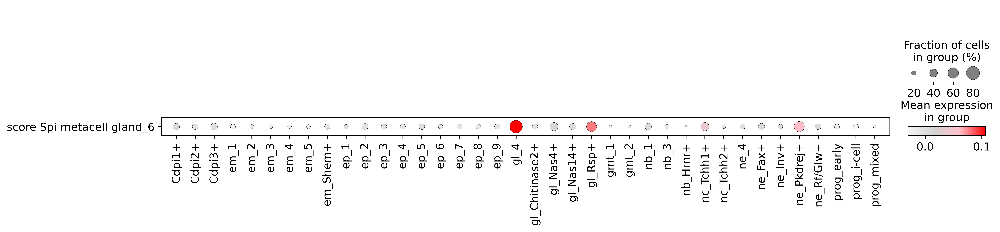

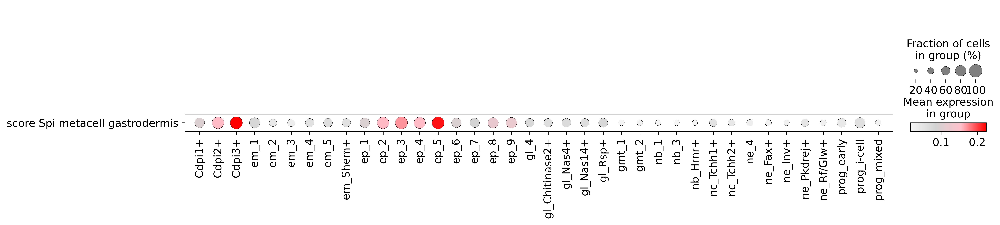

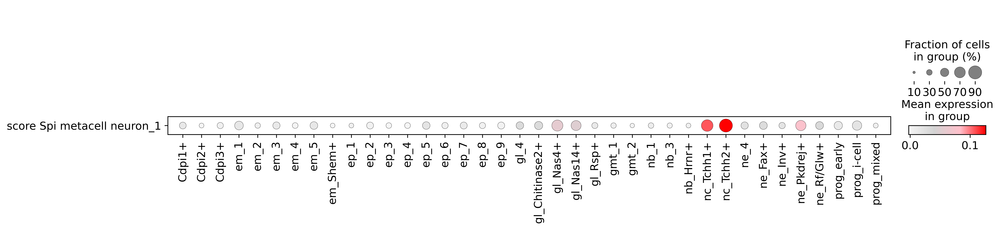

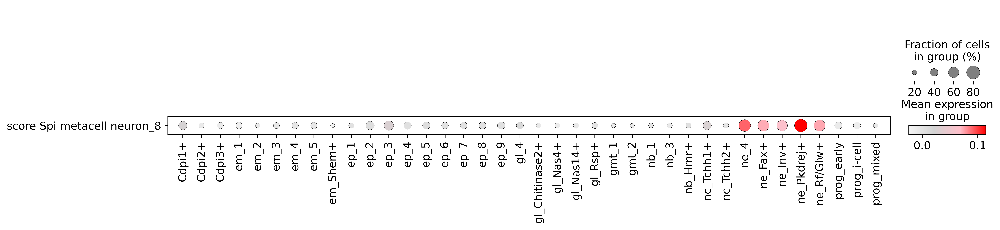

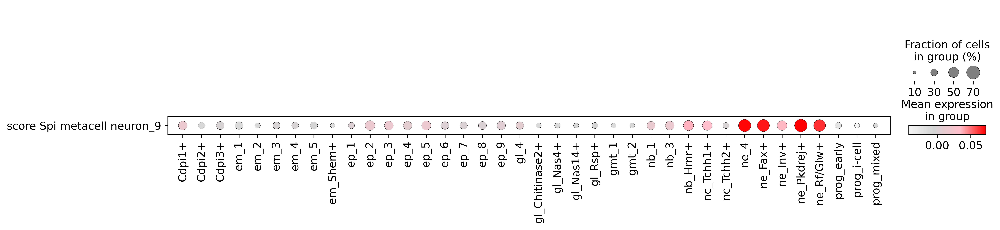

...

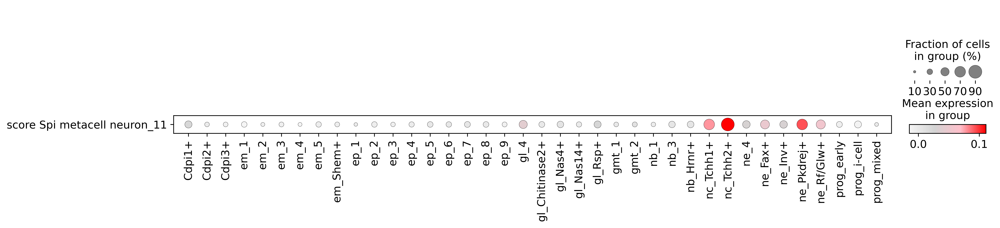

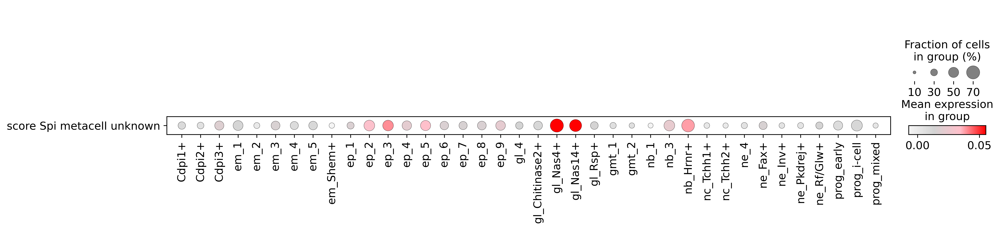

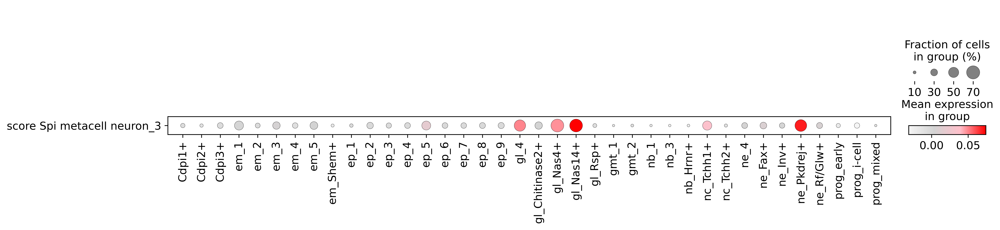

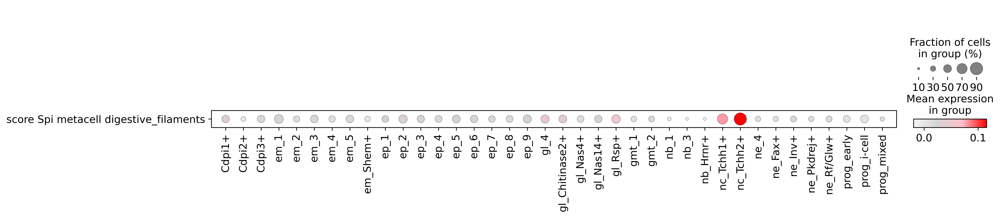

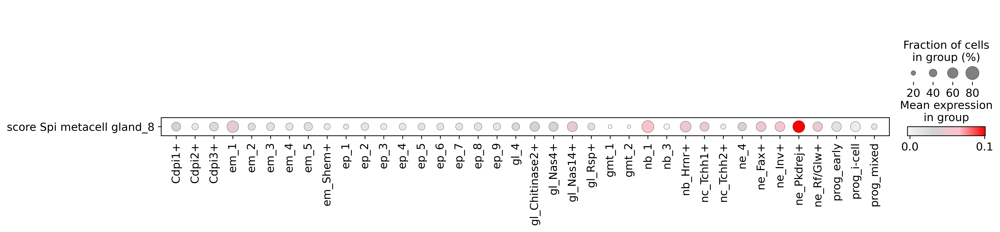

In [ ]:
for i in metacell.keys():
    sc.pl.dotplot(adata,
                      ['score Spi metacell '+i],
                      groupby='leiden_1.5_names',
                      swap_axes=True,
                      cmap=s_cmap,
                      save = 'score_spi_metacell_'+i+'.pdf'
                     )

In [ ]:
(mdata.mod['no'])

AnnData object with n_obs × n_vars = 199113 × 18061
    obs: 'Experiment', 'Library', 'Body_part', 'Presence_of_PEG', 'batch', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden_1', 'leiden_1.5', 'leiden_2', 'Colony_part', 'Unique', 'leiden_1.5_names', 'broad_names', 'score'
    var: 'ratio_with_no', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Colony_part_colors', 'Library_colors', 'broad_names_colors', 'dendrogram_leiden_1.5', 'hvg', 'leiden', 'leiden_1.5_colors', 'leiden_1.5_colors_sorted', 'leiden_1.5_sorted', 'leiden_1_colors', 'leiden_2_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups_logreg_leiden_1', 'rank_genes_groups_logreg_leiden_1.5', 'rank_genes_groups_logreg_leiden_2', 'rank_genes_groups_wilcox_leiden_1', 'rank_genes_groups_wilcox_leiden_1.5', 'rank_genes_groups_wilcox_leiden_2', 'umap', '